<a href="https://colab.research.google.com/github/Kp-hash/VANILLA-GANS/blob/main/Vanilla_FashionMnist_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Module Import
Importing the neccessary packages 

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms 
from torchvision.datasets import FashionMNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader, Dataset,random_split,TensorDataset
import matplotlib.pyplot as plt
from torchsummary import summary
# set the seed
torch.manual_seed(0)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [2]:
# Create a function to show and plot images.

def show_tensor_images(image_tensor, num_images = 25, size=(1,28,28)):
    '''
     This is a function that plots an image: it takes the image tensor, num of images,
     and the image size(CH x H x W)
    '''
    # Detach the image from GPU and attach cpu and reshape the image (B x CH x H x W)
    image_unflat = image_tensor.detach().cpu().view(-1,*size)
    # 

    # Use the make_grid function to plot the image as a grid
    image_grid = make_grid(image_unflat[:num_images], nrow=5)

    #plt.imshow(image_grid.permute(1,2,0).squeeze())

    plt.imshow(image_grid.permute(1,2,0).squeeze())
    plt.show()



# Building the generator component

In [3]:
# Creating the generator block
def get_generator_block(input_dim,output_dim):
    '''
     This function returns a single neuron layer of the generators network given an input
     and output dim.
     Parameters:
         input_dim: This is the dimension of the input vector, a scalar value
         output_dim: This is the dimension of the output vector, a scalar value
     returns:
         This neuron return a single neuron of the generator network after performing 
         a linear transformation, batch normalization and then apply the relu act func
    '''
     # Using the sequntial function to arrange the process
    return nn.Sequential(
        # Apply a linear transformation to the data
        nn.Linear(input_dim, output_dim),
        # Apply the batch normalization
        nn.BatchNorm1d(output_dim),
        # Apply the activation function to return (0,max(x))
        nn.ReLU(inplace=True)

     )

In [4]:
# Verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


In [5]:
# Creating the generator class
class Generator(nn.Module):
    '''
      This is the generator class
      Values:
          z_dim: It takes the noise dimension as a sclar value
          im_dim: It takes the dimension of the images- scalar value(H x W)
          hidden_dim: This is the dimension of the hidden layers a scalar value
    '''
    def __init__(self,z_dim=10,im_dim=784,hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            # input layer of neurons
            get_generator_block(z_dim, hidden_dim),
            # imlement the hidden layer
            get_generator_block(hidden_dim, (2 * hidden_dim)),
            # another hidden layer
            get_generator_block((2*hidden_dim), (4 * hidden_dim)),
            # another hidden layer
            get_generator_block((4*hidden_dim), (8 * hidden_dim)),

            # perform a linear transoformation for the final layer
            nn.Linear((hidden_dim * 8),im_dim),
            # squeeze final output to sigmoid
            nn.Sigmoid()

        )

    # Implement the feed forward network
    def forward(self, noise):
        '''
         This is a function that takes the noise tensor and coompletes
         forward pass.
         Returns:
          This returns the generated images.
         Parameters:
          noise: This is the noise tensor with dimension (n_sample,z_dim)
        '''
        return self.gen(noise)

    # return the generator model
    def get_gen(self):
        return self.gen



In [6]:
gen = Generator()
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=10, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [7]:
# Building the unit test
def test_generator(z_dim, im_dim, hidden_dim, num_test=1000):
    gen = Generator(z_dim,im_dim,hidden_dim).get_gen()

    assert len(gen) == 6
    assert str(gen.__getitem__(4)).replace(' ', '') == \
    f'Linear(in_features={hidden_dim * 8},out_features={im_dim},bias=True)'
    assert str(gen.__getitem__(5)).replace(' ', '') == 'Sigmoid()'
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    # confirming output shape
    assert tuple(test_output.shape) == (num_test,im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(10,10,10)
print('success')

success


In [8]:
# create noise generator
def get_noise(n_samples,z_dim,device='cpu'):
    '''
       This is a function that creates the noise vector for the input.
       Parameters: 
           n_samples: This is the number of noise vectors to be created
           z_dim: This is the dimension of each of the noise vectors.
       Returns:
       input noise vector for the generator
    '''
    return torch.randn(n_samples,z_dim,device=device)

In [9]:
# create the unit test for this 
def test_get_noise(n_samples,z_dim,device):
    g_noise = get_noise(n_samples,z_dim,device)

    assert tuple(g_noise.shape) == (n_samples,z_dim)
    # confirm normal distribution was used
    assert torch.abs(g_noise.std() - torch.tensor(1.0)) < 0.01
    # confirm device
    assert str(g_noise.device).startswith(device)

test_get_noise(1000,100,'cpu')
print('success')

success


# Building the Discriminator component

In [10]:
# creating the Discriminator neuron
def get_discriminator(input_dim,output_dim,slope=0.2):
    '''
      This is a function for a single neural layer for the discriminator.
      Parameters:
          input_dim: This is the input vector dimension
          output_dim: This is the output vector dimension
      Returns:
         a discriminator layer wih linear transformation and act func leakyRelu
    '''
    return nn.Sequential(
        nn.Linear(input_dim,output_dim),
        nn.LeakyReLU(slope,inplace=True)
    )

In [11]:
get_discriminator(4,10)

Sequential(
  (0): Linear(in_features=4, out_features=10, bias=True)
  (1): LeakyReLU(negative_slope=0.2, inplace=True)
)

In [12]:
# Unit test for discriminator block

def test_disc_block(in_features,out_features,slope,num_sample=1000):
    disc = get_discriminator(in_features,out_features,slope)

    assert len(disc) == 2
    test_input = torch.randn(num_sample,in_features)
    test_output = disc(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_sample, out_features)

    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5

    assert str(disc.__getitem__(0)).replace(' ', '') == \
    'Linear(in_features={},out_features={},bias=True)'.format(in_features,out_features)
    assert str(disc.__getitem__(1)).replace(' ', '').replace(',inplace=True', '')\
     == 'LeakyReLU(negative_slope={})'.format(slope)  

test_disc_block(25, 12,slope=0.2)
test_disc_block(15, 28,slope=0.2)
print("Success!") 


Success!


In [13]:
get_discriminator(4,10)

Sequential(
  (0): Linear(in_features=4, out_features=10, bias=True)
  (1): LeakyReLU(negative_slope=0.2, inplace=True)
)

In [14]:
# Creating the discriminator class

class Discriminator(nn.Module):
    '''
       Discriminator class
       Parameters;
          im_dim: Input image dimension, for image into the network
          hidden_dim: Dimension of the hidden layers
          
    '''
    def __init__(self,im_dim=784,hidden_dim=128):
        super(Discriminator,self).__init__()
        self.disc = nn.Sequential(
            # layer 1 of the network
            get_discriminator(im_dim,hidden_dim * 4),
            # Layer 2
            get_discriminator(hidden_dim * 4,hidden_dim * 2),
            # layer 3
            get_discriminator(hidden_dim * 2,hidden_dim),

            # Layer 4 - the output layer(no sigmoid act func since its included in loss)
            nn.Linear(hidden_dim, 1)

        )
    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
        image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image) 
    
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc  

In [15]:
# unit test 
def test_discriminator(im_dim, hidden_dim, num_test=100):
    test_disc = Discriminator(im_dim,hidden_dim).get_disc()

    # check the length of the model
    assert len(test_disc) == 4
    assert type(test_disc.__getitem__(3)) == nn.Linear

    # check the linear layer s correct
    test_input = torch.randn(num_test,im_dim)
    test_output = test_disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


In [16]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
# Load MNIST dataset as tensors
dataloader = DataLoader(
    FashionMNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)




Extracting ./FashionMNIST/raw/train-images-idx3-ubyte.gz to ./FashionMNIST/raw




Extracting ./FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./FashionMNIST/raw




Extracting ./FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./FashionMNIST/raw




Extracting ./FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./FashionMNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


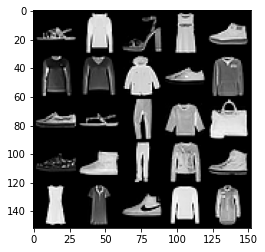

In [17]:
show_tensor_images(next(iter(dataloader))[0])

# Training

In [18]:
# Initializing the generator, discriminator and the optimizer
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

# Creating Loss function

In [19]:
help(get_noise)

Help on function get_noise in module __main__:

get_noise(n_samples, z_dim, device='cpu')
    This is a function that creates the noise vector for the input.
    Parameters: 
        n_samples: This is the number of noise vectors to be created
        z_dim: This is the dimension of each of the noise vectors.
    Returns:
    input noise vector for the generator



In [20]:
# UNQ_C6 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_disc_loss
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images. 
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image 
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a 
    #            'ground truth' tensor in order to calculate the loss. 
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake.detach())
    disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
    disc_real_pred = disc(real)
    disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    #### END CODE HERE ####
    return disc_loss

In [21]:
def test_disc_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data
        
        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")

Success!


## Generator Loss

In [22]:
# UNQ_C7 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images. 
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake)
    gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
    #### END CODE HERE ####
    return gen_loss

In [23]:
def test_gen_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


Step 500: Generator loss: 1.031075661063194, discriminator loss: 0.5360397850871083


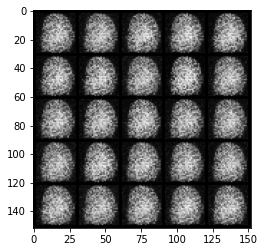

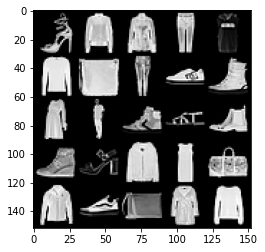

Step 1000: Generator loss: 1.3190328254699686, discriminator loss: 0.37289467215538


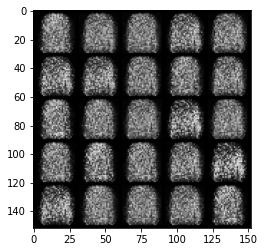

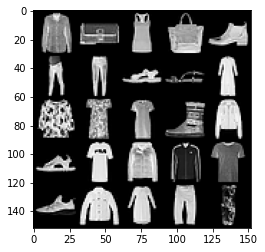

Step 1500: Generator loss: 1.1904588935375204, discriminator loss: 0.4201591586470607


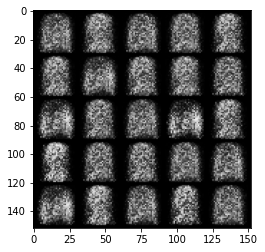

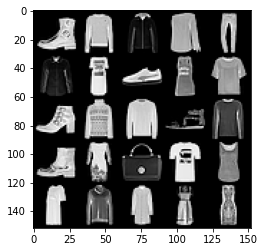

Step 2000: Generator loss: 1.1954189219474798, discriminator loss: 0.4024619593024254


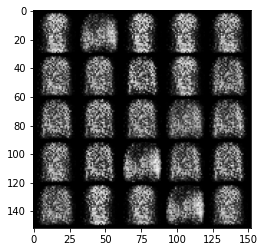

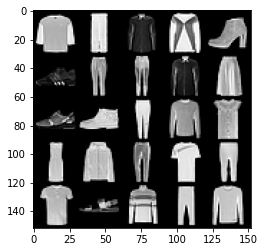

Step 2500: Generator loss: 1.2792958548068993, discriminator loss: 0.3925056327581404


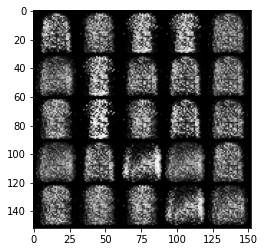

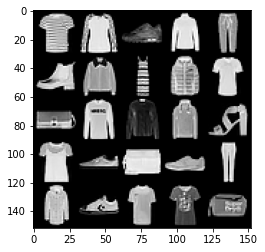

Step 3000: Generator loss: 1.3236157672405242, discriminator loss: 0.39839851385354985


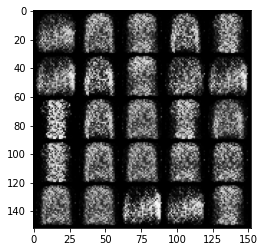

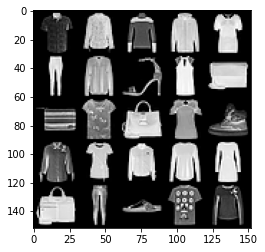

Step 3500: Generator loss: 1.3950223798751846, discriminator loss: 0.3945520005822182


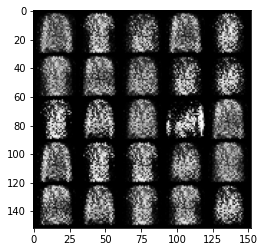

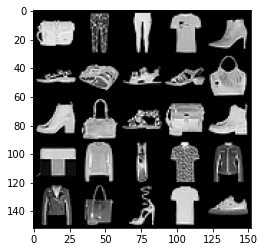

Step 4000: Generator loss: 1.4506334319114706, discriminator loss: 0.38731292980909365


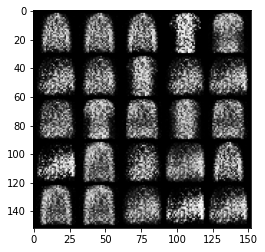

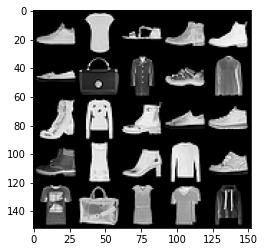

Step 4500: Generator loss: 1.5707440185546897, discriminator loss: 0.3619456539750099


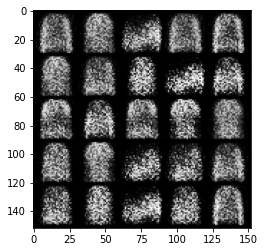

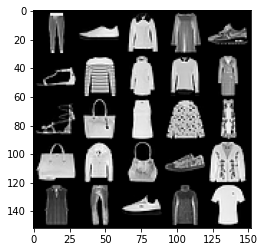

Step 5000: Generator loss: 1.6514653556346914, discriminator loss: 0.34974021345376977


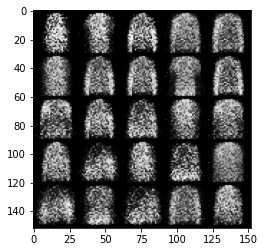

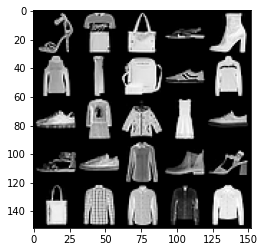

Step 5500: Generator loss: 1.6178822932243342, discriminator loss: 0.36236407816410077


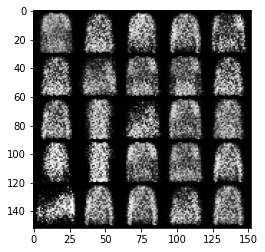

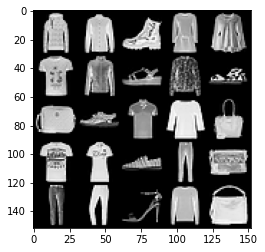

Step 6000: Generator loss: 1.6991212451457975, discriminator loss: 0.35550644004344945


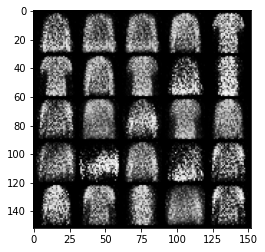

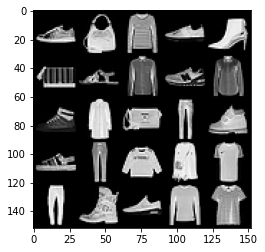

Step 6500: Generator loss: 1.5616335976123805, discriminator loss: 0.3705053691864013


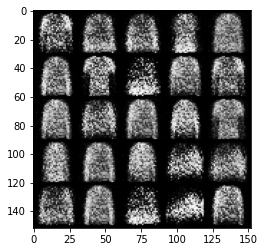

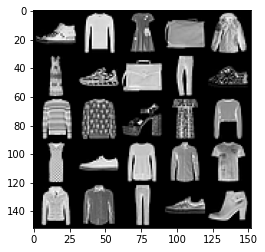

Step 7000: Generator loss: 1.6670716860294337, discriminator loss: 0.36941644859314


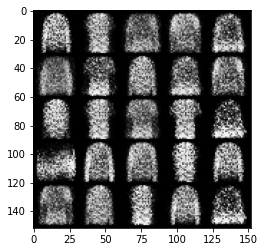

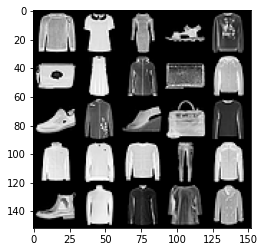

Step 7500: Generator loss: 1.6142585587501534, discriminator loss: 0.3643635022044183


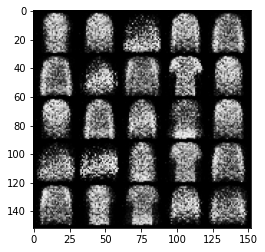

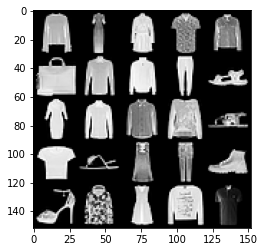

Step 8000: Generator loss: 1.6594377489089969, discriminator loss: 0.36290417248010637


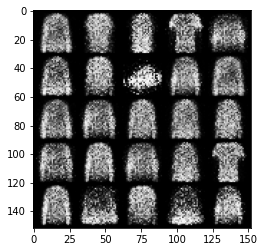

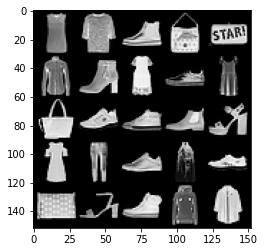

Step 8500: Generator loss: 1.6830707378387448, discriminator loss: 0.35296647030115125


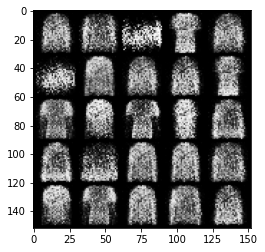

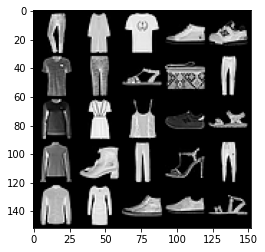

Step 9000: Generator loss: 1.6609793705940241, discriminator loss: 0.36573677670955657


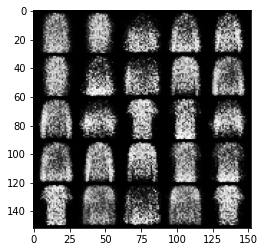

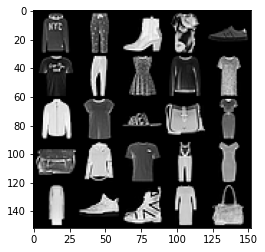

Step 9500: Generator loss: 1.5752237126827242, discriminator loss: 0.38011329913139336


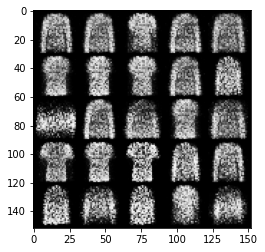

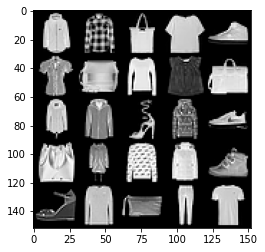

Step 10000: Generator loss: 1.6036332011222827, discriminator loss: 0.3759397147893904


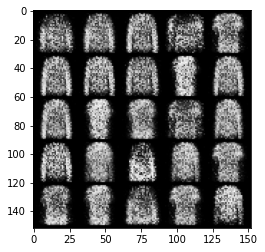

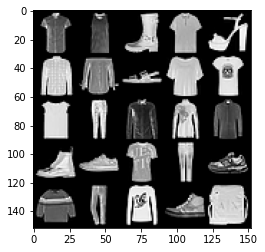

Step 10500: Generator loss: 1.6193241884708423, discriminator loss: 0.3782370400428771


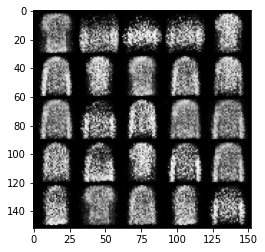

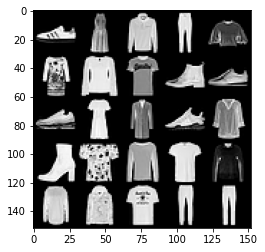

Step 11000: Generator loss: 1.5935856499671937, discriminator loss: 0.38221026021242177


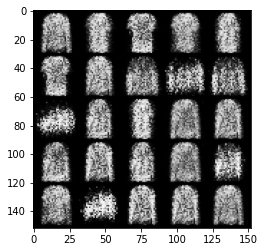

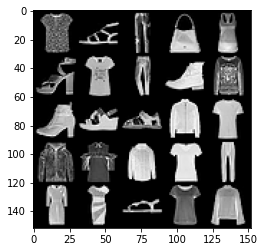

Step 11500: Generator loss: 1.689170010089874, discriminator loss: 0.36340546160936343


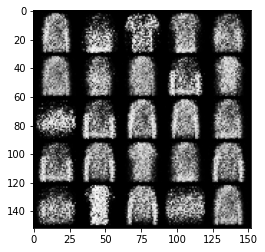

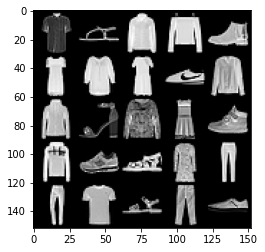

Step 12000: Generator loss: 1.6102319960594176, discriminator loss: 0.37707935780286755


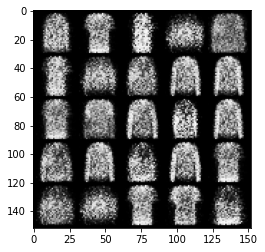

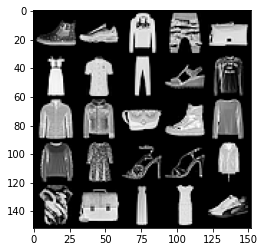

Step 12500: Generator loss: 1.556245813131333, discriminator loss: 0.38935615968704224


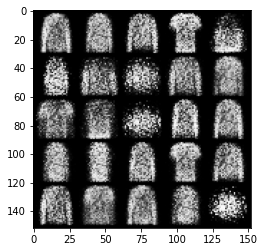

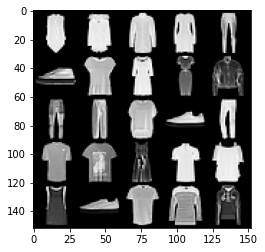

Step 13000: Generator loss: 1.6062490327358234, discriminator loss: 0.37977138531208043


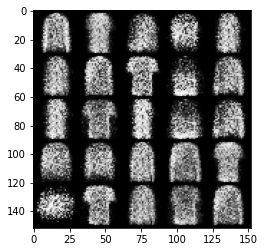

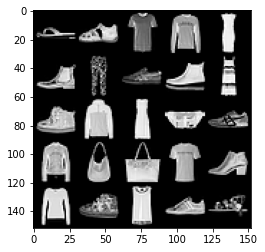

Step 13500: Generator loss: 1.5494752767086024, discriminator loss: 0.41390405845642053


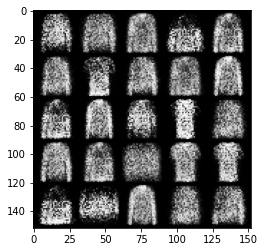

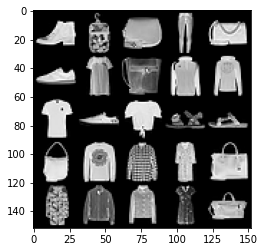

Step 14000: Generator loss: 1.5317250030040748, discriminator loss: 0.40538071882724797


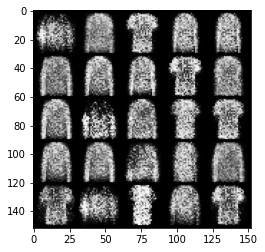

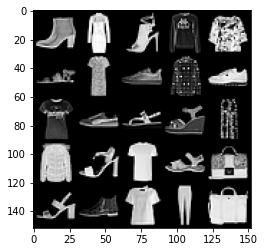

Step 14500: Generator loss: 1.507573256015778, discriminator loss: 0.41701244992017733


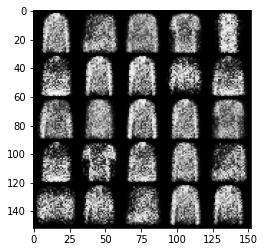

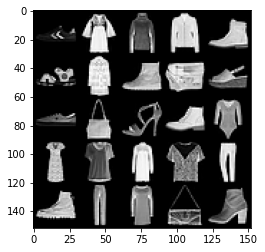

Step 15000: Generator loss: 1.5423067073822023, discriminator loss: 0.4097012358903884


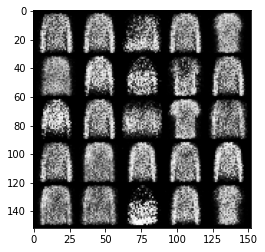

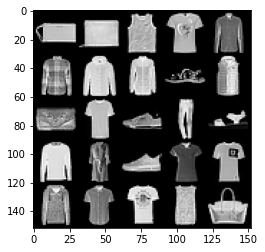

Step 15500: Generator loss: 1.5246204595565795, discriminator loss: 0.4159487720727917


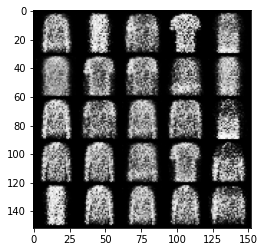

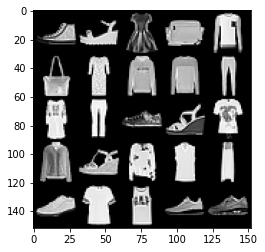

Step 16000: Generator loss: 1.5191952989101414, discriminator loss: 0.4172881701588633


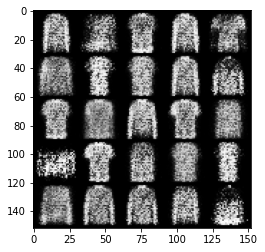

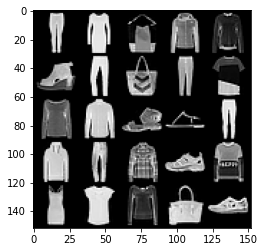

Step 16500: Generator loss: 1.5491650397777552, discriminator loss: 0.39922656846046445


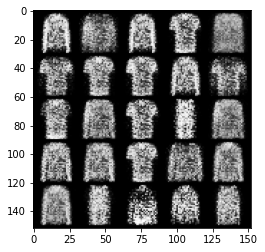

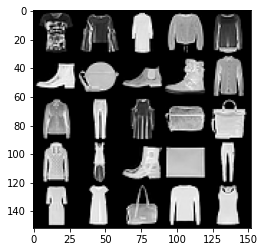

Step 17000: Generator loss: 1.4876282832622532, discriminator loss: 0.42311093378067033


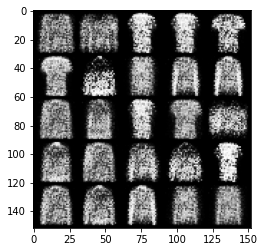

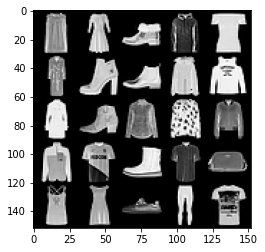

Step 17500: Generator loss: 1.5771055016517637, discriminator loss: 0.3986877146959308


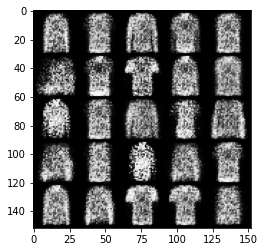

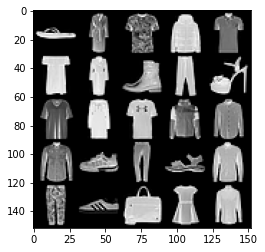

Step 18000: Generator loss: 1.5585387804508217, discriminator loss: 0.39598202347755423


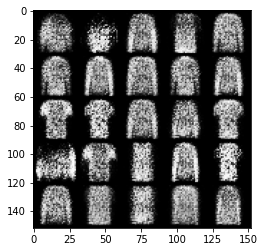

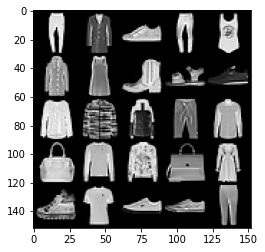

Step 18500: Generator loss: 1.5920544142723088, discriminator loss: 0.39480833560228346


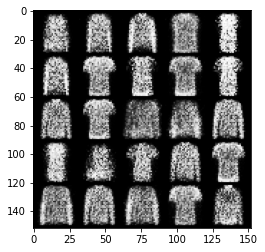

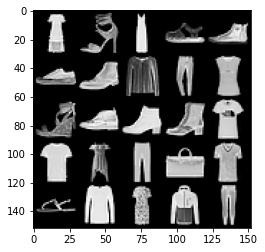

Step 19000: Generator loss: 1.549319288969039, discriminator loss: 0.40788109338283535


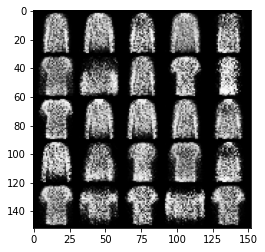

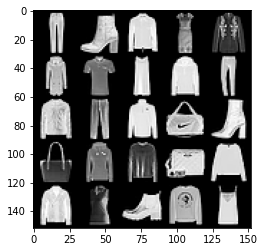

Step 19500: Generator loss: 1.5109867613315582, discriminator loss: 0.41339108258485774


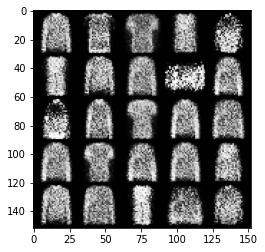

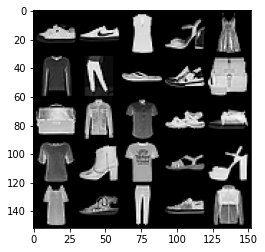

Step 20000: Generator loss: 1.4726464769840244, discriminator loss: 0.41802607548236836


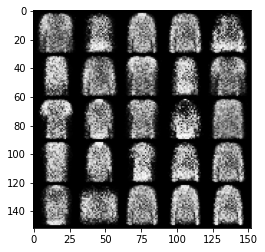

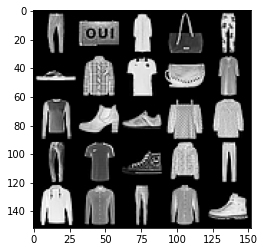

Step 20500: Generator loss: 1.45386231637001, discriminator loss: 0.4312595471739768


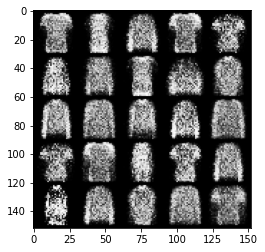

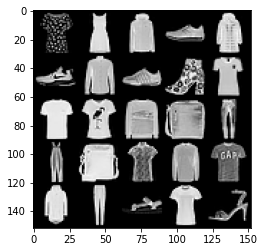

Step 21000: Generator loss: 1.463535424470902, discriminator loss: 0.42264750456810046


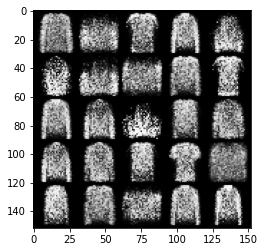

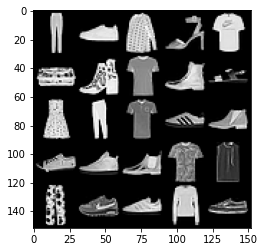

Step 21500: Generator loss: 1.473393496751785, discriminator loss: 0.4144489036798476


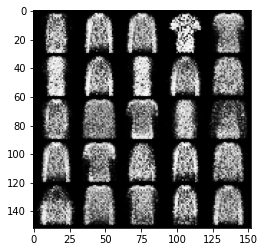

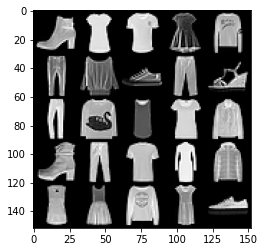

Step 22000: Generator loss: 1.4935550951957712, discriminator loss: 0.4169876044392585


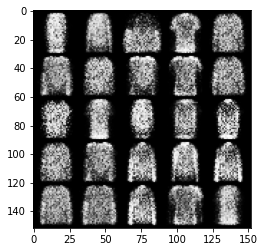

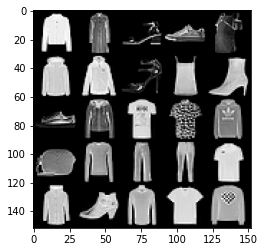

Step 22500: Generator loss: 1.4399913351535802, discriminator loss: 0.42398132848739656


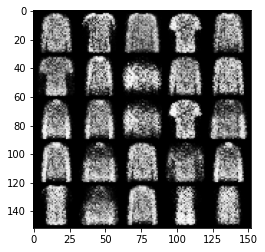

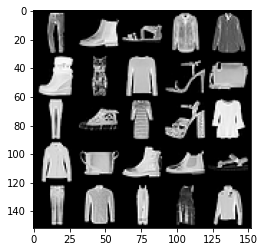

Step 23000: Generator loss: 1.3816761560440063, discriminator loss: 0.4396241626143454


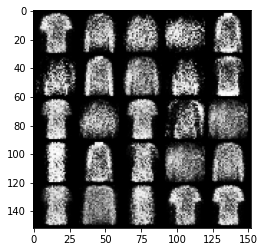

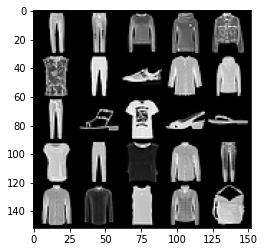

Step 23500: Generator loss: 1.4513679370880121, discriminator loss: 0.429438917040825


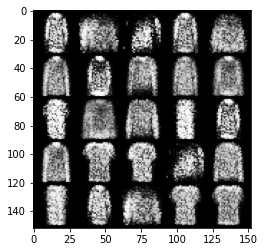

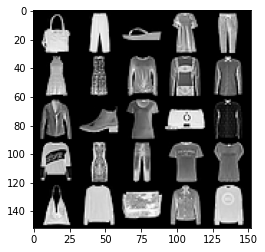

Step 24000: Generator loss: 1.3427465422153482, discriminator loss: 0.44696707624196996


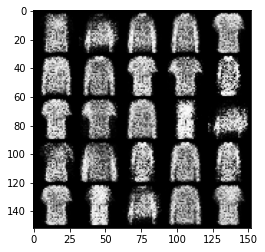

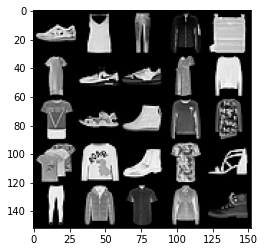

Step 24500: Generator loss: 1.4318833079338096, discriminator loss: 0.4265832393169407


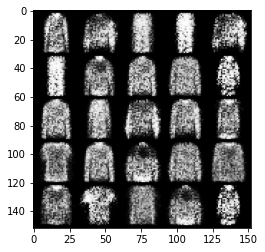

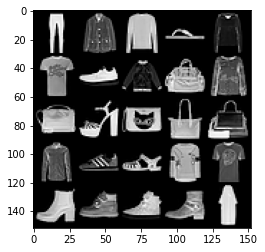

Step 25000: Generator loss: 1.3703242352008813, discriminator loss: 0.446864867210388


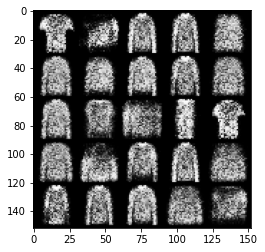

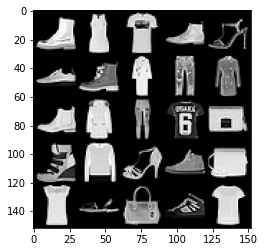

Step 25500: Generator loss: 1.3945594699382777, discriminator loss: 0.4314845575094226


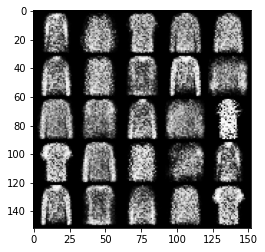

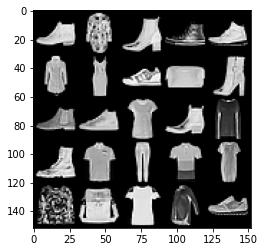

Step 26000: Generator loss: 1.4281323916912068, discriminator loss: 0.4207102939486501


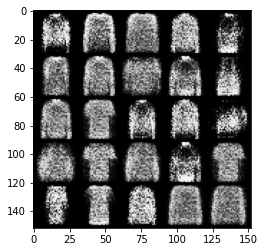

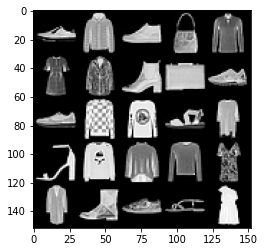

Step 26500: Generator loss: 1.3988342988491045, discriminator loss: 0.4296248988509178


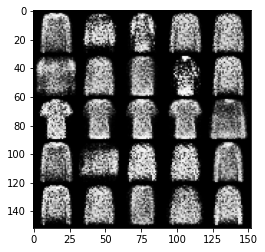

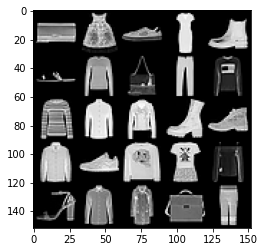

Step 27000: Generator loss: 1.386911847591401, discriminator loss: 0.4362532426714895


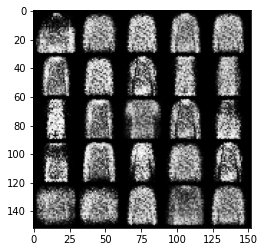

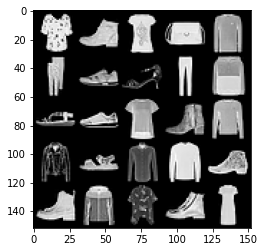

Step 27500: Generator loss: 1.421258678913119, discriminator loss: 0.43234777688980097


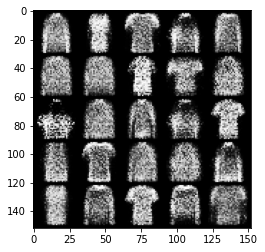

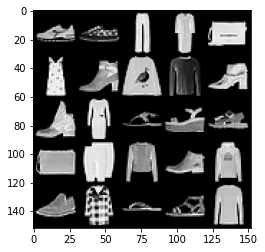

Step 28000: Generator loss: 1.3732444088459017, discriminator loss: 0.4304110853075978


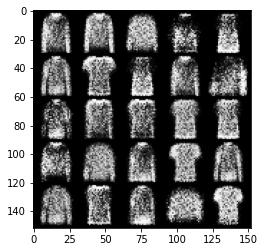

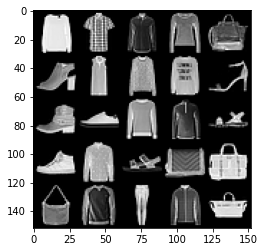

Step 28500: Generator loss: 1.434344876766203, discriminator loss: 0.4209520288109779


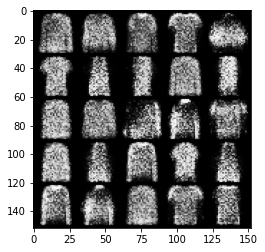

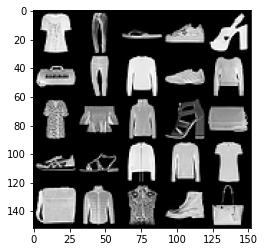

Step 29000: Generator loss: 1.4794279792308815, discriminator loss: 0.4051048178672791


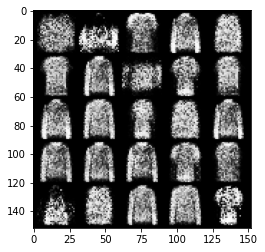

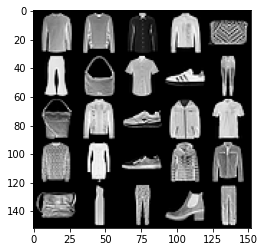

Step 29500: Generator loss: 1.3163984329700487, discriminator loss: 0.44665880370140054


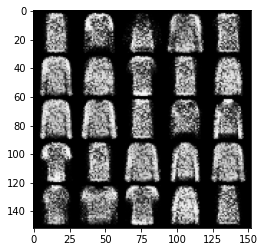

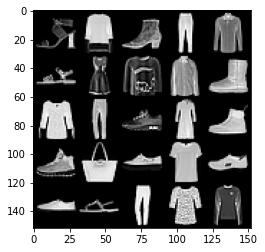

Step 30000: Generator loss: 1.389656240463258, discriminator loss: 0.4252761801481252


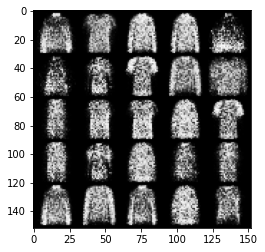

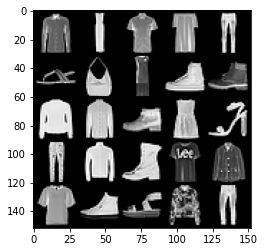

Step 30500: Generator loss: 1.3542558257579806, discriminator loss: 0.42889633876085315


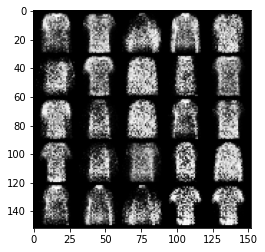

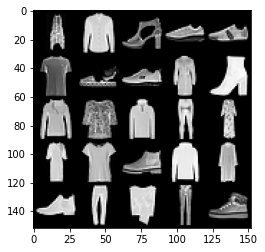

Step 31000: Generator loss: 1.3798053057193769, discriminator loss: 0.4380988786220549


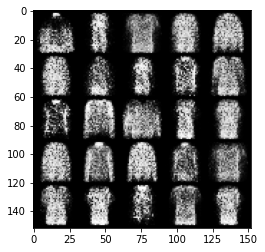

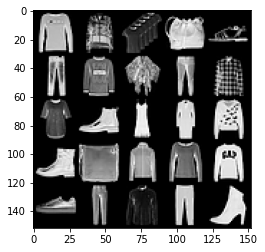

Step 31500: Generator loss: 1.2819536499977116, discriminator loss: 0.45735219109058417


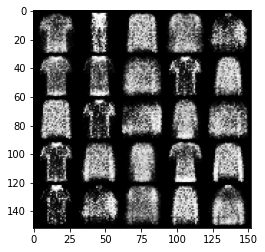

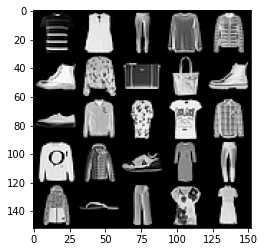

Step 32000: Generator loss: 1.315202130079268, discriminator loss: 0.45700630092620886


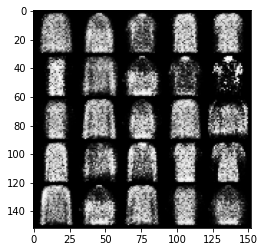

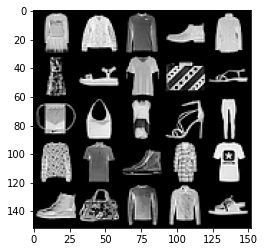

Step 32500: Generator loss: 1.344398382663726, discriminator loss: 0.4496172113418581


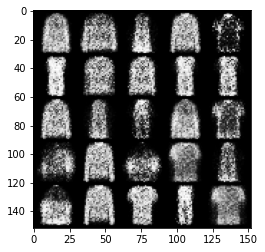

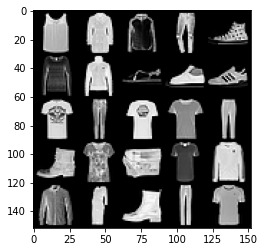

Step 33000: Generator loss: 1.2495084872245805, discriminator loss: 0.4633713712692263


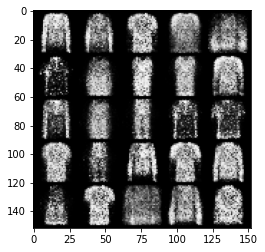

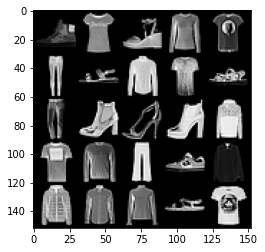

Step 33500: Generator loss: 1.2894489421844495, discriminator loss: 0.4471140817403792


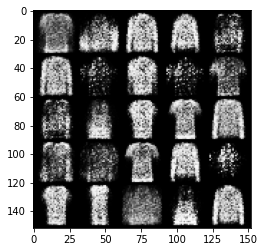

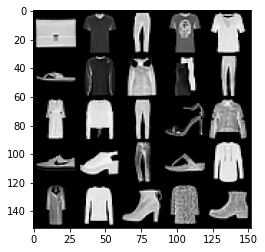

Step 34000: Generator loss: 1.251011644363403, discriminator loss: 0.45040181815624203


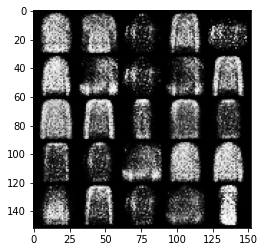

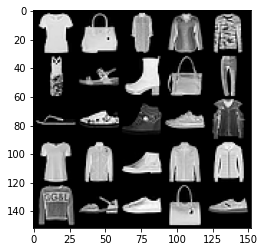

Step 34500: Generator loss: 1.2105142281055452, discriminator loss: 0.4760190575122831


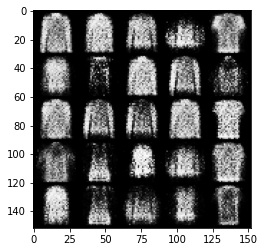

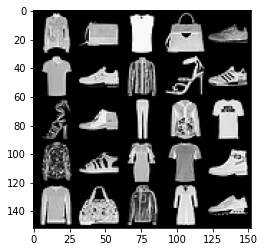

Step 35000: Generator loss: 1.211648058652877, discriminator loss: 0.4680852264761925


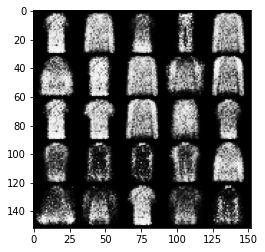

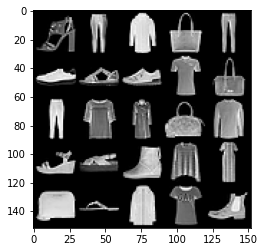

Step 35500: Generator loss: 1.1537813560962675, discriminator loss: 0.4803601601123809


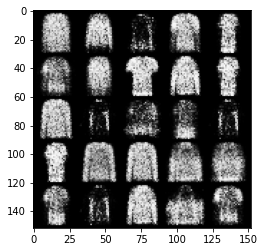

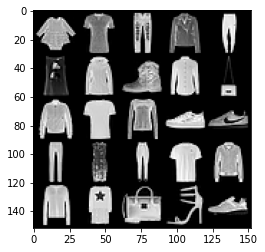

Step 36000: Generator loss: 1.199060113191603, discriminator loss: 0.47542337357997905


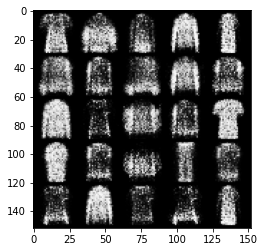

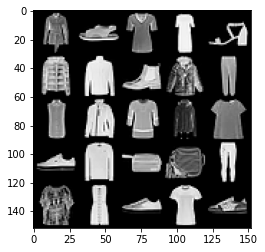

Step 36500: Generator loss: 1.1278109331130977, discriminator loss: 0.4959434399008753


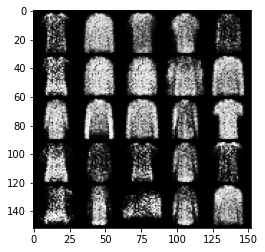

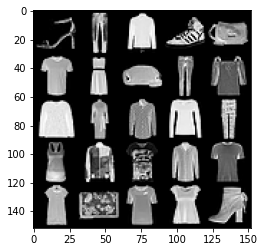

Step 37000: Generator loss: 1.127381470918655, discriminator loss: 0.502539917051792


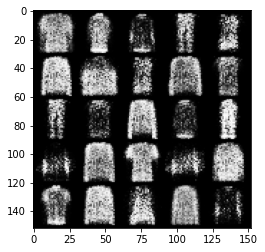

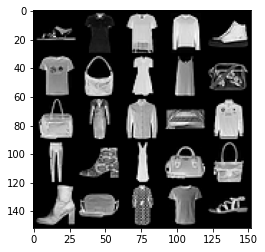

Step 37500: Generator loss: 1.1189206113815302, discriminator loss: 0.50702366822958


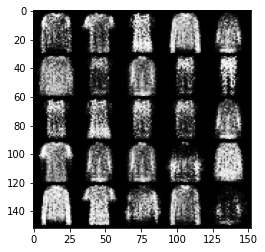

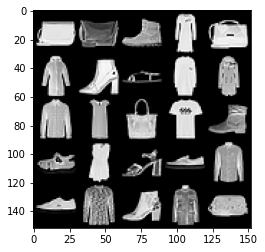

Step 38000: Generator loss: 1.0408580851554865, discriminator loss: 0.5259189490079877


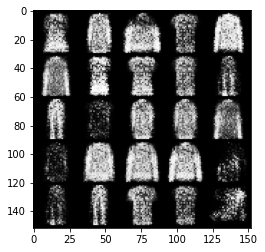

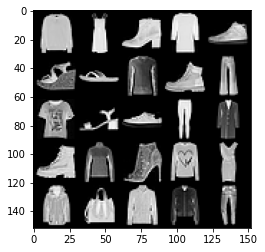

Step 38500: Generator loss: 1.0853305280208585, discriminator loss: 0.5256131953597071


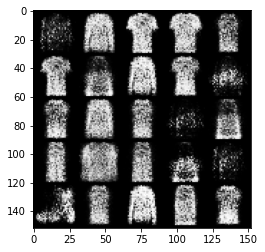

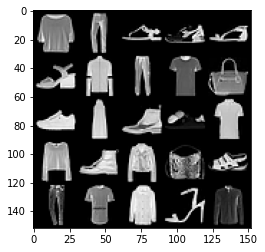

Step 39000: Generator loss: 1.0970993037223817, discriminator loss: 0.5106540761590007


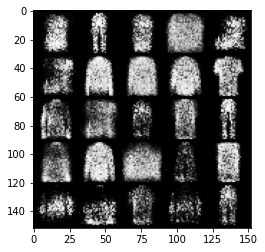

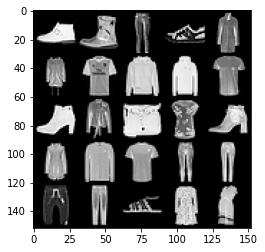

Step 39500: Generator loss: 1.0896490947008126, discriminator loss: 0.5270101737976071


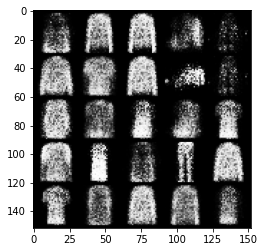

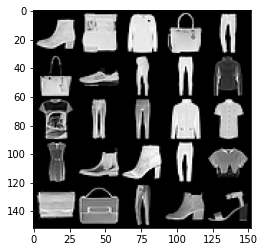

Step 40000: Generator loss: 1.0449046028852464, discriminator loss: 0.5136019914746286


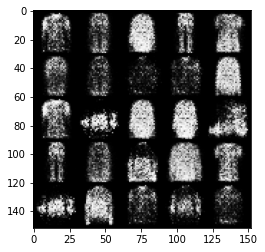

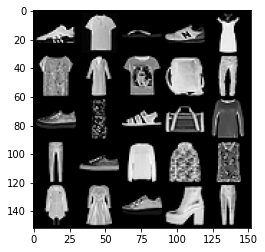

Step 40500: Generator loss: 1.0559698009490968, discriminator loss: 0.528547585129738


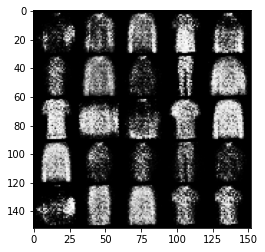

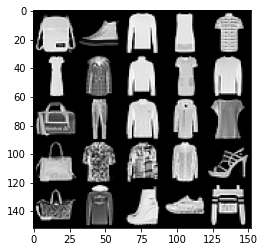

Step 41000: Generator loss: 1.0336308224201194, discriminator loss: 0.5355954814553259


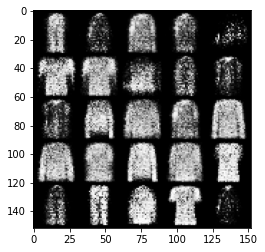

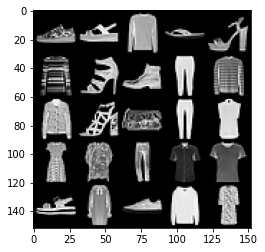

Step 41500: Generator loss: 0.9386973096132273, discriminator loss: 0.5597970138192173


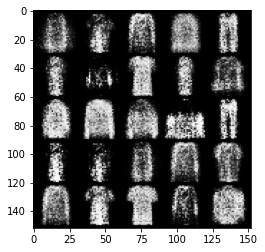

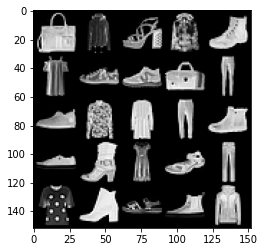

Step 42000: Generator loss: 1.079371607184409, discriminator loss: 0.5474494349956506


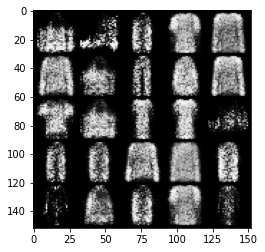

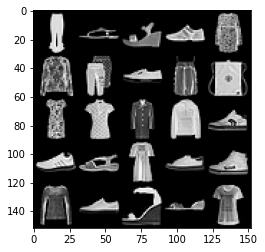

Step 42500: Generator loss: 0.9702129104137418, discriminator loss: 0.5467797818183897


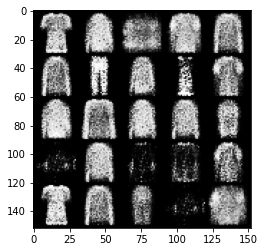

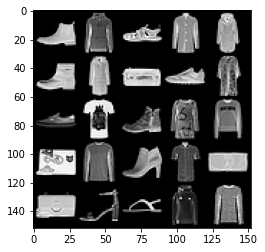

Step 43000: Generator loss: 1.053732218742372, discriminator loss: 0.5459511770606043


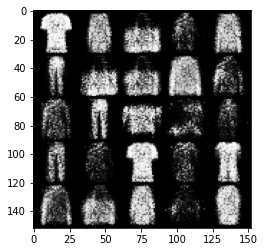

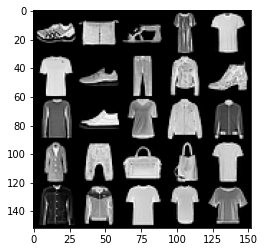

Step 43500: Generator loss: 0.9559756835699084, discriminator loss: 0.563537277281285


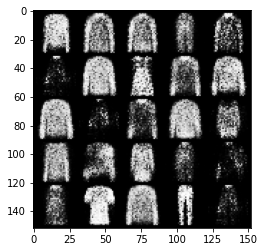

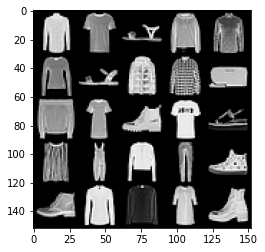

Step 44000: Generator loss: 1.0180918660163867, discriminator loss: 0.5553979643583299


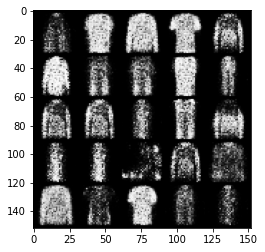

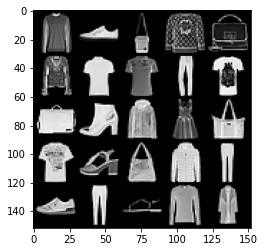

Step 44500: Generator loss: 0.953306367635726, discriminator loss: 0.5656184880137448


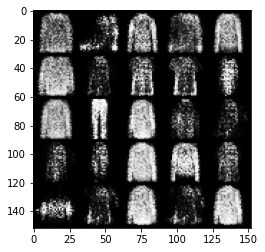

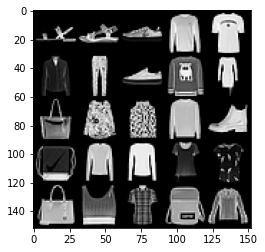

Step 45000: Generator loss: 1.002080044507981, discriminator loss: 0.557875467658043


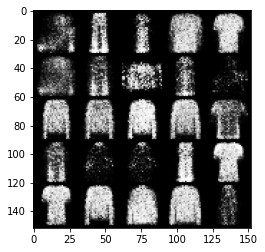

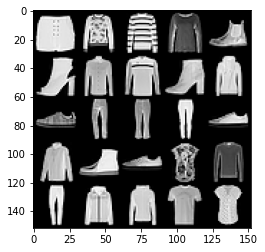

Step 45500: Generator loss: 0.9702721045017233, discriminator loss: 0.557750598013401


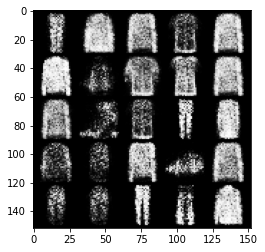

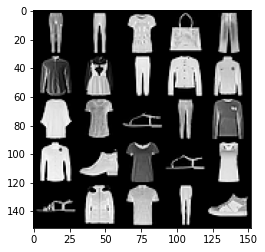

Step 46000: Generator loss: 0.9888418720960609, discriminator loss: 0.5611066306829454


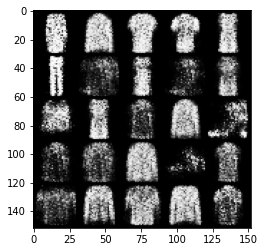

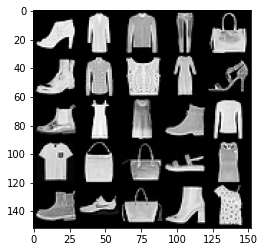

Step 46500: Generator loss: 1.0044398983716964, discriminator loss: 0.5538943351507183


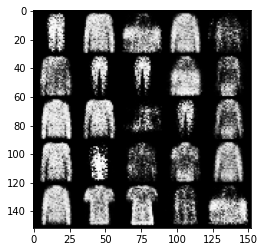

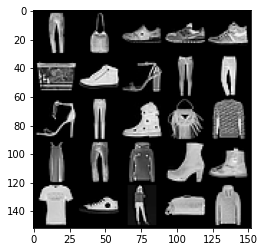

Step 47000: Generator loss: 0.9543858026266097, discriminator loss: 0.5666236065030099


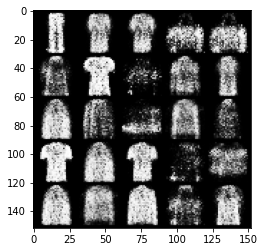

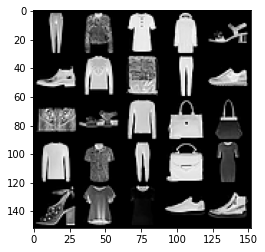

Step 47500: Generator loss: 0.9846177132129671, discriminator loss: 0.5563577183485028


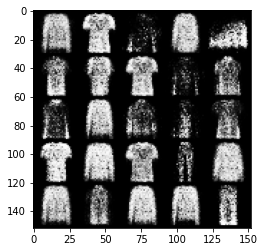

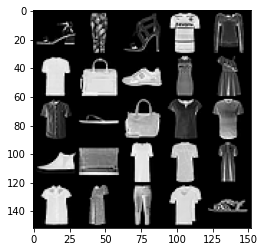

Step 48000: Generator loss: 0.9084204354286178, discriminator loss: 0.5767862389087677


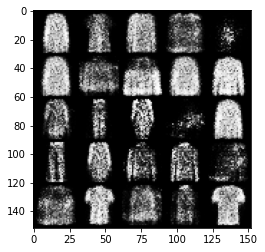

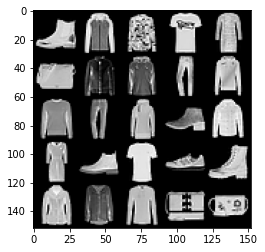

Step 48500: Generator loss: 0.9956476405859008, discriminator loss: 0.5606766408681869


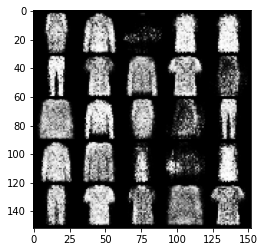

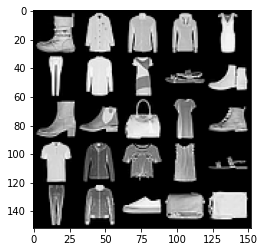

Step 49000: Generator loss: 0.885646893262864, discriminator loss: 0.5840221855640408


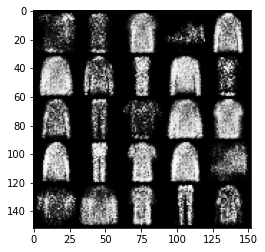

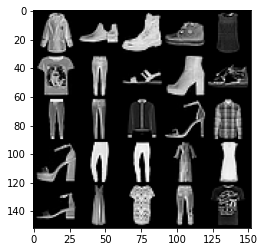

Step 49500: Generator loss: 0.9646862770318981, discriminator loss: 0.5785600945949558


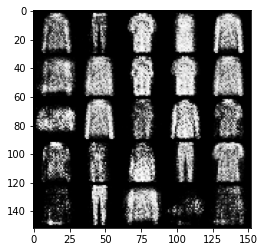

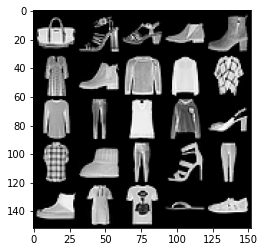

Step 50000: Generator loss: 0.9318691549301151, discriminator loss: 0.5807425557374953


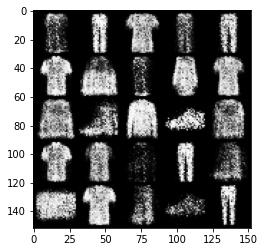

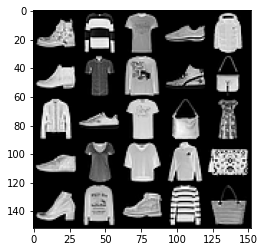

Step 50500: Generator loss: 0.934770600080489, discriminator loss: 0.5842382813692093


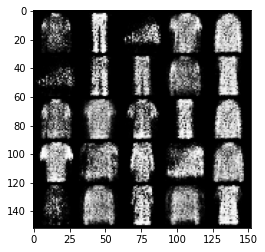

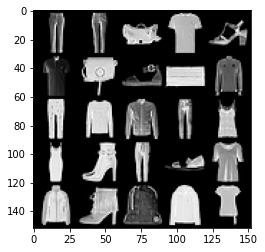

Step 51000: Generator loss: 0.9492146413326275, discriminator loss: 0.5791870033740996


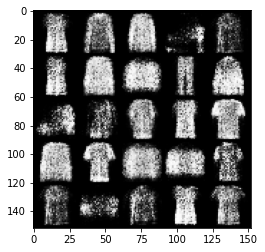

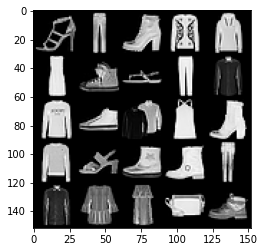

Step 51500: Generator loss: 0.8772509936094272, discriminator loss: 0.5932064102888106


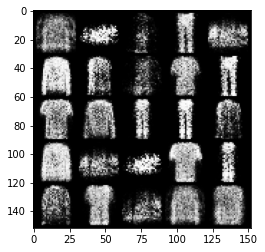

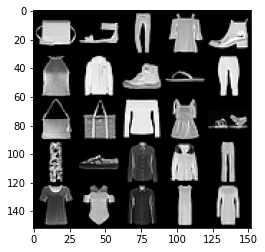

Step 52000: Generator loss: 1.006599568963051, discriminator loss: 0.5739407516717913


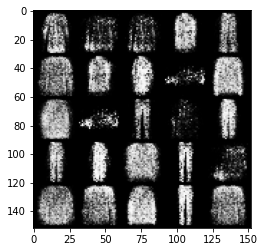

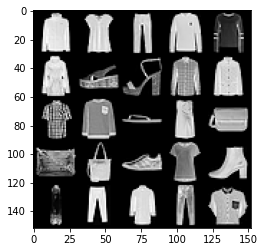

Step 52500: Generator loss: 0.8873475691080094, discriminator loss: 0.5758779956102377


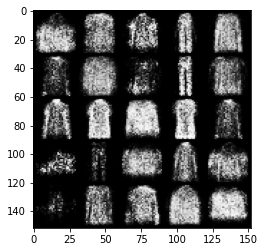

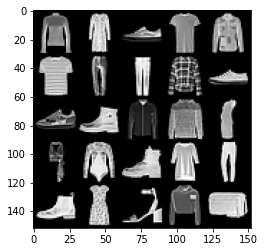

Step 53000: Generator loss: 0.9128008707761767, discriminator loss: 0.6022064211368561


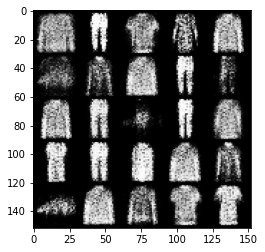

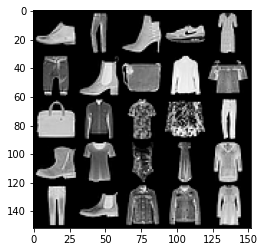

Step 53500: Generator loss: 0.8887888358831405, discriminator loss: 0.6004665338993077


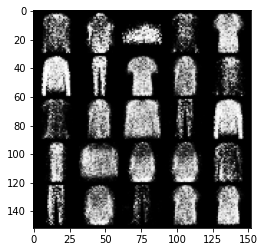

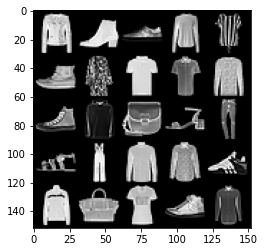

Step 54000: Generator loss: 0.8828258734941478, discriminator loss: 0.6056670469045636


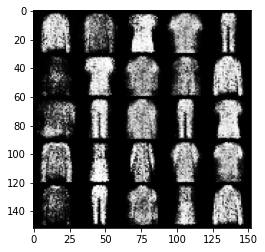

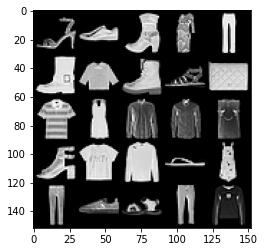

Step 54500: Generator loss: 0.8897076143026345, discriminator loss: 0.6062386963367463


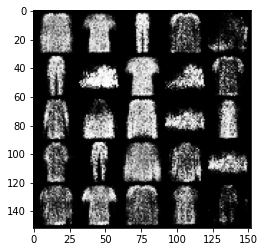

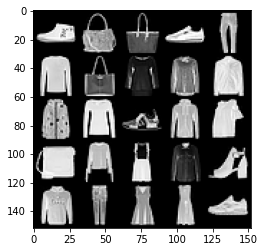

Step 55000: Generator loss: 0.8683470679521558, discriminator loss: 0.6127072645425793


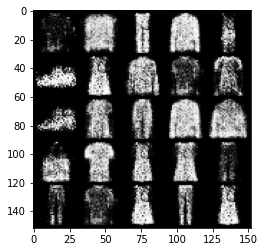

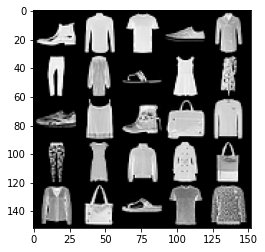

Step 55500: Generator loss: 0.9425214481353755, discriminator loss: 0.5943375662565222


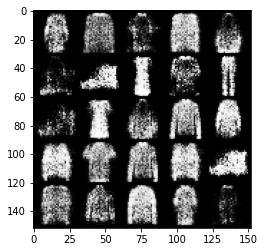

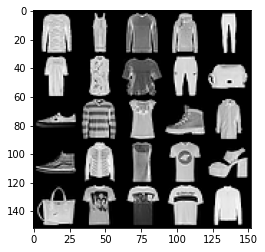

Step 56000: Generator loss: 0.8526286764144891, discriminator loss: 0.6096358754634856


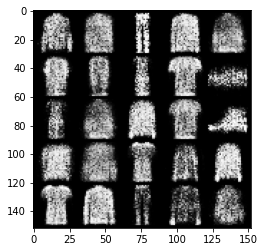

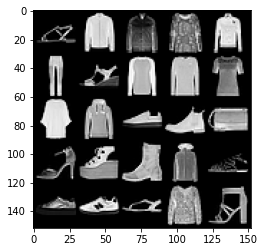

Step 56500: Generator loss: 0.9137215024232873, discriminator loss: 0.6080372166633604


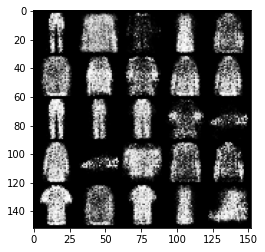

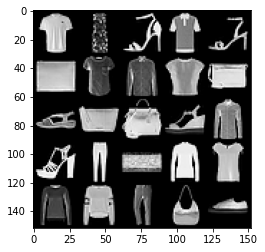

Step 57000: Generator loss: 0.8465264068841942, discriminator loss: 0.615302710533142


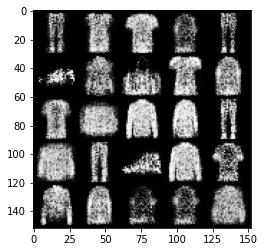

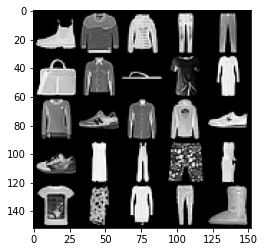

Step 57500: Generator loss: 0.8925169725418086, discriminator loss: 0.6175965318679805


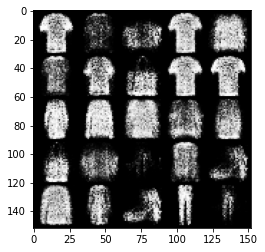

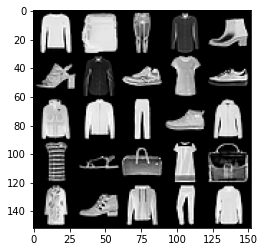

Step 58000: Generator loss: 0.8346444821357729, discriminator loss: 0.6265178409814834


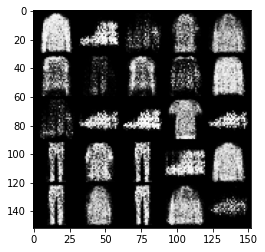

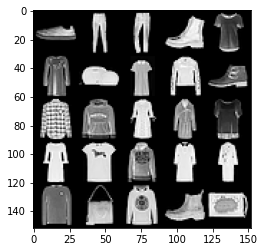

Step 58500: Generator loss: 0.817240224957466, discriminator loss: 0.6374949678182597


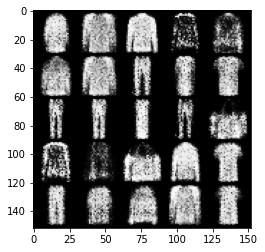

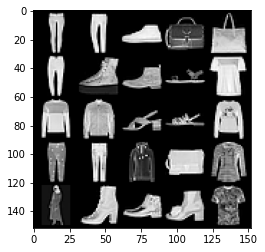

Step 59000: Generator loss: 0.876530605077743, discriminator loss: 0.6184847322702411


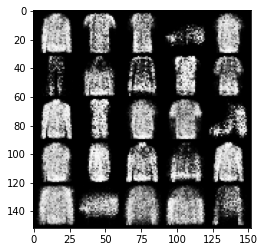

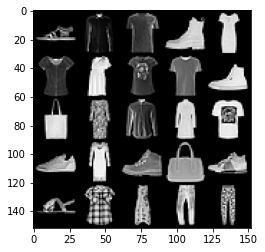

Step 59500: Generator loss: 0.8806931223869311, discriminator loss: 0.6120239921808247


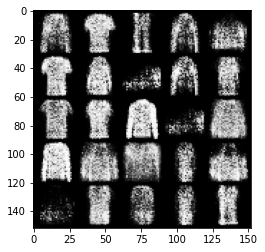

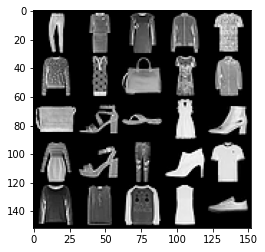

Step 60000: Generator loss: 0.8389605077505113, discriminator loss: 0.6200362551212302


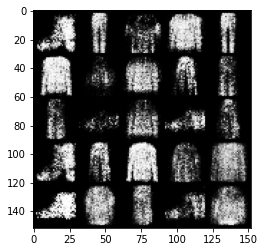

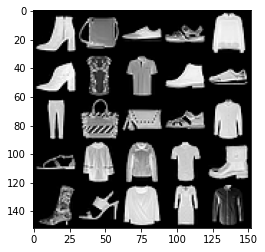

Step 60500: Generator loss: 0.8566626019477834, discriminator loss: 0.620240956783295


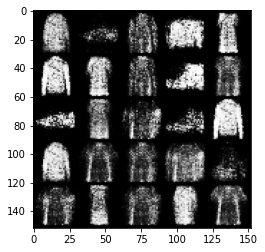

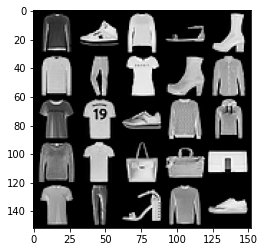

Step 61000: Generator loss: 0.8457829067707053, discriminator loss: 0.6207461276054387


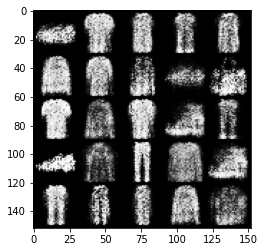

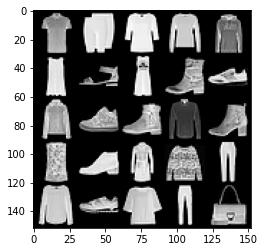

Step 61500: Generator loss: 0.907857143044472, discriminator loss: 0.6198687524795535


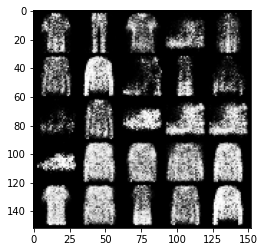

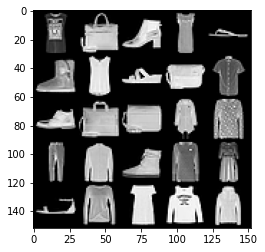

Step 62000: Generator loss: 0.8107287430763245, discriminator loss: 0.6207593704462053


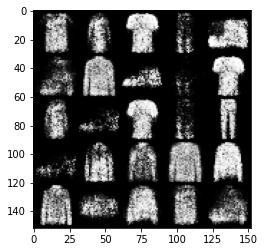

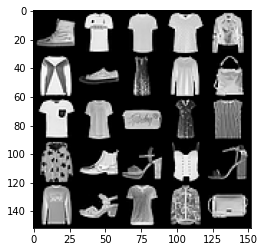

Step 62500: Generator loss: 0.8398618948459627, discriminator loss: 0.6370736687183377


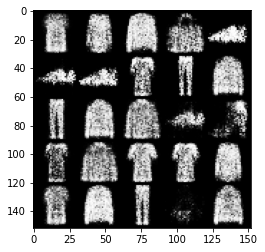

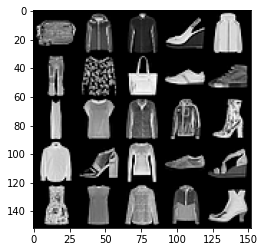

Step 63000: Generator loss: 0.838331593036651, discriminator loss: 0.6353166245222098


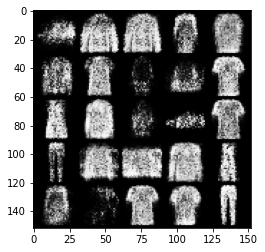

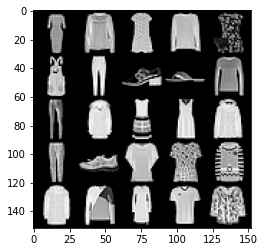

Step 63500: Generator loss: 0.8323330730199812, discriminator loss: 0.6269253771305084


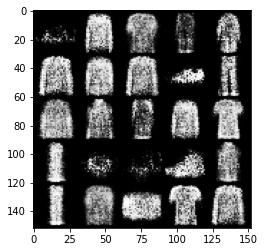

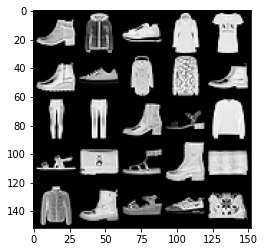

Step 64000: Generator loss: 0.8485686680078507, discriminator loss: 0.6249192076921459


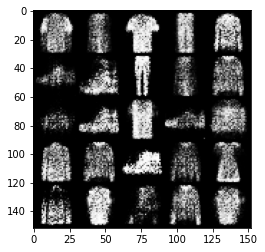

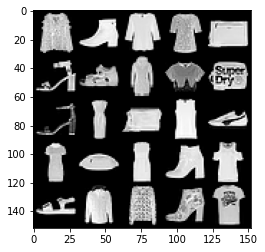

Step 64500: Generator loss: 0.8133184287548064, discriminator loss: 0.6389603118896487


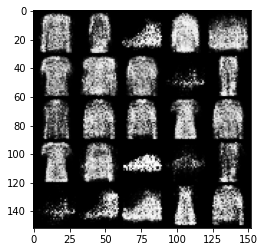

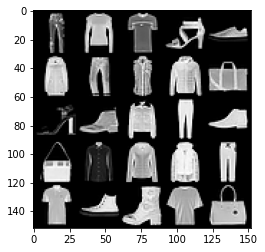

Step 65000: Generator loss: 0.8227892761230459, discriminator loss: 0.6399287327527999


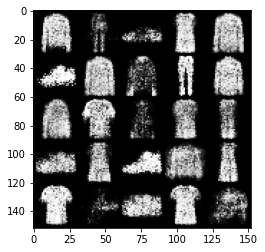

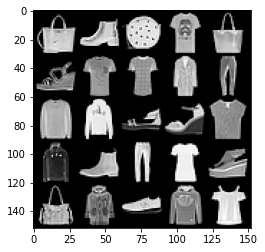

Step 65500: Generator loss: 0.8215127525329591, discriminator loss: 0.6327722915410994


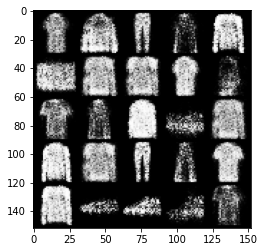

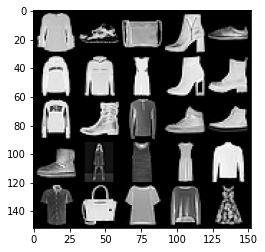

Step 66000: Generator loss: 0.8048042455911633, discriminator loss: 0.647244451642036


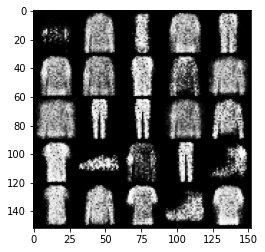

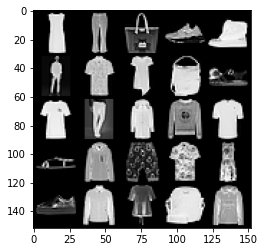

Step 66500: Generator loss: 0.8069079353809352, discriminator loss: 0.6417041711807258


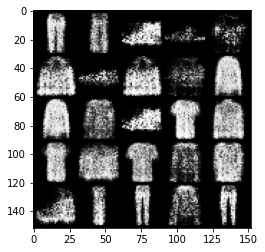

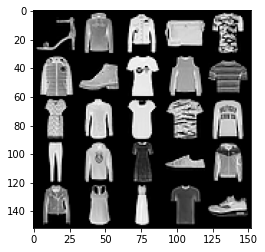

Step 67000: Generator loss: 0.8079427028894414, discriminator loss: 0.6442086224555966


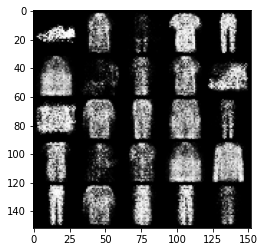

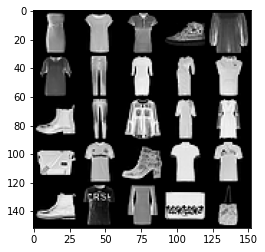

Step 67500: Generator loss: 0.8026042802333835, discriminator loss: 0.6425482867956165


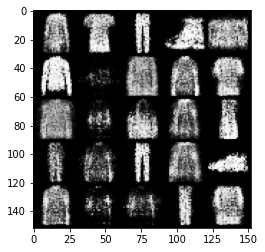

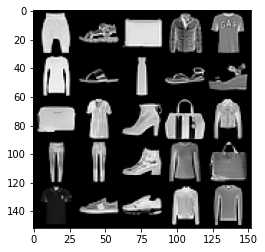

Step 68000: Generator loss: 0.8116394758224492, discriminator loss: 0.6429756400585175


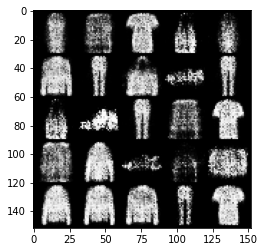

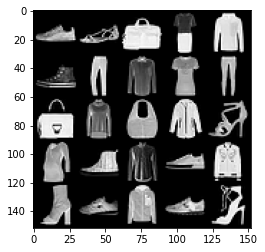

Step 68500: Generator loss: 0.7911702306270594, discriminator loss: 0.6494713734388352


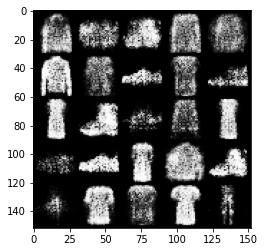

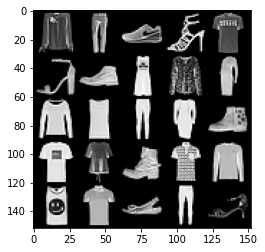

Step 69000: Generator loss: 0.831436028122902, discriminator loss: 0.6339750456809998


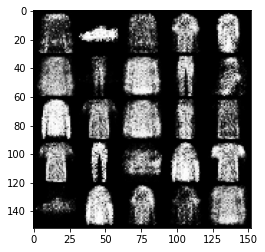

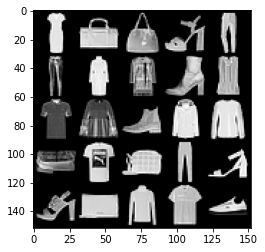

Step 69500: Generator loss: 0.792540625333786, discriminator loss: 0.651533541798592


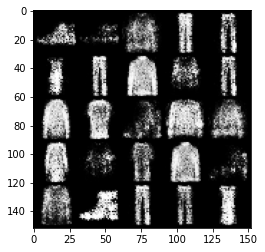

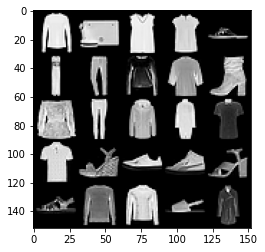

Step 70000: Generator loss: 0.8020690928697582, discriminator loss: 0.6374397093057633


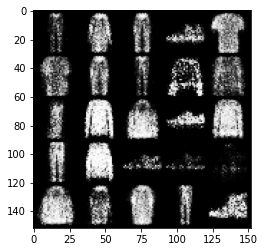

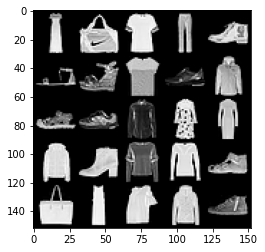

In [24]:
# UNQ_C8 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: 

cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False
for epoch in range(n_epochs):
  
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1